# Mega StratBuilder

This is the neatened StratBuilder code with some of my annoying essays. The main draw of this code is that it houses the components to interpret cross-stream and down stream sections, you just have to declare it. This code works by importing the full grids from NAYS2DH as a NumPy array and pulling out the model results for a specified location. It basically functions in 3 parts:
1. Data import
2. Plotting
3. Exports and some preliminary statistics

## Declare cross-stream or downstream flags

In [1]:
sec_flag = input('What kinds of sections are you plotting: XS or DWN: ')

What kinds of sections are you plotting: XS or DWN:  XS


## Import packages

In [2]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import csv
import os
import scipy.stats as stats
import seaborn as sns
import math 
import matplotlib.animation as animation
import matplotlib.colors as mcol
import matplotlib.cm as cm
import time
import random
import statistics as stat
import collections
import copy 

import matplotlib.gridspec as gridspec

from os import listdir
from os.path import isfile, join
import PIL
from scipy.interpolate import griddata

from xml.dom import minidom
from shapely.geometry import Polygon, MultiPolygon
#from matplotlib.animation import FuncAnimation

#from descartes import PolygonPatch
#from PIL import Image
from scipy.spatial import distance
from scipy import signal
from scipy import interpolate
from scipy.stats import variation
from mpl_toolkits.axes_grid1 import make_axes_locatable
from IPython.display import Image
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from celluloid import Camera
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#plt.style.use('seaborn-white')

from matplotlib.collections import LineCollection, PatchCollection
from matplotlib.colors import ListedColormap, BoundaryNorm, LinearSegmentedColormap

%matplotlib inline
#%matplotlib qt
#%matplotlib notebook
#from google.colab import drive
#drive.mount("/content/gdrive")

##### Setting up all the aesthetics:
Import new colormapas, reverse them, create plot style (font, font size, etc)

In [3]:
font = {'family' : 'Helvetica',
        'weight' : 'normal',
        'size'   : 10}

mpl.rc('font', **font)
kwargs = dict(edgecolor = 'k', fc = 'xkcd:greyish', alpha=0.5, bins=20)

In [4]:
 ###### source of this function: http://schubert.atmos.colostate.edu/~cslocum/custom_cmap.html#code
def make_cmap(colors, position=None, bit=False):

    if len(position) != len(colors):
        sys.exit('position length must be the same as colors')
    elif position[0] != 0 or position[-1] != 1:
        sys.exit('position must start with 0 and end with 1')
    
    cdict = {'red':[], 'green':[], 'blue':[]}
    for pos, color in zip(position, colors):

        cdict['red'].append((pos, color[0], color[0]))
        cdict['green'].append((pos, color[1], color[1]))
        cdict['blue'].append((pos, color[2], color[2]))

        cmap = mpl.colors.LinearSegmentedColormap('my_colormap',cdict,256)

    return cmap

##### load source xml file
xmldoc = minidom.parse('/Volumes/SAF_Data/Python/colourmaps/mellow-rainbow.xml')
itemlist = xmldoc.getElementsByTagName('Point')
data_vals=[]
color_vals=[]

for s in itemlist:
    
    data_vals.append(float(s.attributes['x'].value))
    color_vals.append((float(s.attributes['r'].value),
    float(s.attributes['g'].value),
    float(s.attributes['b'].value)))

##### construct the colormap

mycmap = make_cmap(color_vals,data_vals) ###this is the main rainbow colourmap to be used in the code
# print('converted successfully!')

#mycmap_r = ListedColormap(mycmap.colors[::-1])

# mycmap is matplotlib compatible object. to query color value out of it:

#print('example rgba value for data value 0 is: ' + str(mycmap(0.0)))

##### load source xml file
xmldoc = minidom.parse('/Volumes/SAF_Data/Python/colourmaps/brown-2.xml')
itemlist = xmldoc.getElementsByTagName('Point')
data_vals=[]
color_vals=[]

for s in itemlist:
    
    data_vals.append(float(s.attributes['x'].value))
    color_vals.append((float(s.attributes['r'].value),
    float(s.attributes['g'].value),
    float(s.attributes['b'].value)))

##### construct the colormap

ss_facies = make_cmap(color_vals,data_vals) ###this is the main rainbow colourmap to be used in the code
# print('converted successfully!')

##### load source xml file
xmldoc = minidom.parse('/Volumes/SAF_Data/Python/colourmaps//green-brown-div.xml')
itemlist = xmldoc.getElementsByTagName('Point')
data_vals=[]
color_vals=[]

for s in itemlist:
    
    data_vals.append(float(s.attributes['x'].value))
    color_vals.append((float(s.attributes['r'].value),
    float(s.attributes['g'].value),
    float(s.attributes['b'].value)))

##### construct the colormap

grads = make_cmap(color_vals,data_vals) ###this is the main rainbow colourmap to be used in the code
# print('converted successfully!')

xmldoc = minidom.parse('/Volumes/SAF_Data/Python/colourmaps/blue-3.xml')
itemlist = xmldoc.getElementsByTagName('Point')
data_vals=[]
color_vals=[]

for s in itemlist:
    
    data_vals.append(float(s.attributes['x'].value))
    color_vals.append((float(s.attributes['r'].value),
    float(s.attributes['g'].value),
    float(s.attributes['b'].value)))

##### construct the colormap

depths = make_cmap(color_vals,data_vals) ###this is the main rainbow colourmap to be used in the code
# print('converted successfully!')

###for velocities

xmldoc = minidom.parse('/Volumes/SAF_Data/Python/colourmaps/orange-6.xml')
itemlist = xmldoc.getElementsByTagName('Point')
data_vals=[]
color_vals=[]

for s in itemlist:
    
    data_vals.append(float(s.attributes['x'].value))
    color_vals.append((float(s.attributes['r'].value),
    float(s.attributes['g'].value),
    float(s.attributes['b'].value)))

##### construct the colormap

vels = make_cmap(color_vals,data_vals) ###this is the main rainbow colourmap to be used in the code
# print('converted successfully!')


# xmldoc = minidom.parse('/Volumes/SAF_Data/Python/colourmaps/1-3wbgy.xml')
# itemlist = xmldoc.getElementsByTagName('Point')
# data_vals=[]
# color_vals=[]

# for s in itemlist:
    
#     data_vals.append(float(s.attributes['x'].value))
#     color_vals.append((float(s.attributes['r'].value),
#     float(s.attributes['g'].value),
#     float(s.attributes['b'].value)))

# ##### construct the colormap

# planformcmap = make_cmap(color_vals,data_vals) ###this is the main rainbow colourmap to be used in the code
# print('converted successfully!')



In [5]:
def reverse_colourmap(cmap, name = 'my_cmap_r'):
    reverse = []
    k = []   

    for key in cmap._segmentdata:    
        k.append(key)
        channel = cmap._segmentdata[key]
        data = []

        for t in channel:                    
            data.append((1-t[0],t[2],t[1]))            
        reverse.append(sorted(data))    

    LinearL = dict(zip(k,reverse))
    my_cmap_r = mpl.colors.LinearSegmentedColormap(name, LinearL) 
    return my_cmap_r

In [6]:
def hex_to_rgb(value):
    '''
    Converts hex to rgb colours
    value: string of 6 characters representing a hex colour.
    Returns: list length 3 of RGB values'''
    value = value.strip("#") # removes hash symbol if present
    lv = len(value)
    return tuple(int(value[i:i + lv // 3], 16) for i in range(0, lv, lv // 3))


def rgb_to_dec(value):
    '''
    Converts rgb to decimal colours (i.e. divides each value by 256)
    value: list (length 3) of RGB values
    Returns: list (length 3) of decimal values'''
    return [v/256 for v in value]

def get_continuous_cmap(hex_list, float_list=None):
    ''' creates and returns a color map that can be used in heat map figures.
        If float_list is not provided, colour map graduates linearly between each color in hex_list.
        If float_list is provided, each color in hex_list is mapped to the respective location in float_list. 
        
        Parameters
        ----------
        hex_list: list of hex code strings
        float_list: list of floats between 0 and 1, same length as hex_list. Must start with 0 and end with 1.
        
        Returns
        ----------
        colour map'''
    rgb_list = [rgb_to_dec(hex_to_rgb(i)) for i in hex_list]
    if float_list:
        pass
    else:
        float_list = list(np.linspace(0,1,len(rgb_list)))
        
    cdict = dict()
    for num, col in enumerate(['red', 'green', 'blue']):
        col_list = [[float_list[i], rgb_list[i][num], rgb_list[i][num]] for i in range(len(float_list))]
        cdict[col] = col_list
    cmp = mcol.LinearSegmentedColormap('my_cmp', segmentdata=cdict, N=256)
    return cmp

In [7]:

# Links for colourmap help

# big up towards data science for the tutorial:
# https://towardsdatascience.com/creating-colormaps-in-matplotlib-4d4de78a04b8

# diy cmap from twoards data science, again: https://towardsdatascience.com/beautiful-custom-colormaps-with-matplotlib-5bab3d1f0e72


##### DEFINE COLOURMAPS
x, y = np.mgrid[-5:5:0.05, -5:5:0.05]
z = (np.sqrt(x**2 + y**2) + np.sin(x**2 + y**2))
hex_list = ['#0091ad', '#3fcdda', '#83f9f8', '#d6f6eb', '#fdf1d2', '#f8eaad', '#faaaae', '#ff57bb']
planform_colours = ['#3f9b0b', '#e2ca76', '#886806','02ccfe','#0485d1','#0504aa', ] 
                ###grass green, sand, shit, muddy brown, turquoise, cerulean, royal blue 

temperate= ['3f9b0b', 'bf9005', '02ccfe','3c9992', '0485d1', '0504aa' ] #ugly and green and glue
                    #dark tan, sand, sea green, cerulean, navy blue
test = ['a75e09','bd6c48', 'af884a', 'cb7723','7bc8f6','069af3', '0e87cc', '2242c77', '0504aa', '00035b'] 
#raw umber, adobe, dark tan, brownish orange, light blue, azure, water blue,  blue blue, royal blue, dark blue    
#test  = ['bd6c48','cb7723','ad8150', '0e87cc', '0504aa', '00035b']
#adobe, brownish orange, dark tan, light brown,water blue, royal blue, dark blue
glacial = ['ffffcb', 'e2ca76','bf9005', '7f5e00','6dedfd', '02ccfe','0504aa']
#dark sand, light grey, stone, azure, navy blue
redyellow = ['cf0234','e50000','ffffff', 'ffff14', 'fec615']
#cherry, red, white, yellow, golden yellow
redblue = ['cf0234','e50000', 'ffffff','152eff', '0203e2']
redblue_r = ['0203e2', '152eff','ffffff', 'e50000', 'cf0234']
yellowblue = ['fec615', 'ffff14', 'ffffff','152eff', '0203e2']
centrelines = ['ffffff', '000000']
discrete_channel = ['af884a', 'cb7723', '2242c77', '00035b']
#dark tan, brownish orange, water blue, dark blue
#cherry, red, white, vivid blue, pure blue

In [8]:
class MidpointNormalize(mcol.Normalize):
    def __init__(self, vmin=None, vmax=None, vcenter=None, clip=False):
        self.vcenter = vcenter
        mcol.Normalize.__init__(self, vmin, vmax, clip)

    def __call__(self, value, clip=None):
        # I'm ignoring masked values and all kinds of edge cases to make a
        # simple example...
        x, y = [self.vmin, self.vcenter, self.vmax], [0, 0.5, 1]
        return np.ma.masked_array(np.interp(value, x, y))

In [9]:
#planformcmap = reverse_colourmap(planformcmap)

In [10]:
ss_facies_r = reverse_colourmap(ss_facies)
timesteps_r = reverse_colourmap(mycmap)

### Important model parameters that might be used in calculation + import data:
At the moment (March 22) the only things we need to set are:
1. cross-section location (I and J)
1. DV flag (0 for none, 1 for variable)
1. adjustment time (60 for the 2 hour strat given an average adj time of 120 hours)

Need to expand and change cell width and length if not using a 4x10 cell size!

In [11]:
Q = str(100)# discharge in m3/s
slope = 0.00137#gradient
d50 = 0.31e-3 #d50 grain size in m

thot_SS = 0 # 802800
#time from which we restarted the runs to add a flood
fldstart_s = 802800 ###start time of flood in seconds
variabd = int(input('Enter DV flag: ')) #flag for if in variable discharge regime
adjustment_time = int(input('Enter bed adjustment time here, be wary of timestep conversion: ')) #number of timesteps, in hours taken for bed to equilibrate

fldlength = 0
idf = '0hfld' #identifier/classifier about the flood setting
intstring = '2hour' #time interval of output
nickname = 'agubh2-10km' #model nickname, agubh2, gentle_wide etc
floodname ='_0hrflood'

datnam = f'{idf}-datamaster-{intstring}-ud.npy' #name of the data file to upload
dataloc = f'data-{nickname}{floodname}' #where csv files are
arrayfolder = f'c-{idf}-{nickname}' #where raw centroid data array stored
mainsurfto = f'ms-{idf}-{nickname}' #where bounding surfaces array will go
iricoutputt =600 #output time from the model, s

print(f'/Volumes/SAF_Data/Data/ConvertedArrays/{dataloc}/{datnam}')
datamaster = np.load(f'/Volumes/SAF_Data/NAYS2DH_files/Data/ConvertedArrays/{dataloc}/{datnam}', allow_pickle = True)

iloc = int(input('I-location is '))#location of the section along i axis
jloc = int(input('j-location is '))#location of the secion along j axis


Enter DV flag:  0
Enter bed adjustment time here, be wary of timestep conversion:  65


/Volumes/SAF_Data/Data/ConvertedArrays/data-agubh2-10km_0hrflood/0hfld-datamaster-2hour-ud.npy


I-location is  100
j-location is  14


### More model domain set up

In [12]:
cellW = 4
cellL = 10
xloc = iloc*cellL
xsloc = iloc*cellL
#print(xsloc)
spacing = 1 #spacing of cross stream x locations, m

ps = 2650 # bulk density of quartz kg/m3
p = 1000 # density of water in kg/m3
nu = 1.787*10e-6 #kinematic viscosity of water in m2/s
nu=1.0533e-6
g = 9.81 # acceleration due to gravity, m/s2

savefilesto = '/Volumes/SAF_Data/NAYS2DH_files/Plots/'
modelrun = f'{nickname}-{idf}-{iloc}'

In [13]:
###define grid dimensions
gridx = 1001
gridy = 26

datacond = 1
if datacond == 1:
    cells = gridy
else:
    cells = gridx
length = 1001 #length of the domain in the x direction
erostart = 5
erostop = 5

print('Shape of the datamaster dataset is: ', datamaster.shape)

Shape of the datamaster dataset is:  (26026, 11, 382)


In [14]:
num_timesteps = datamaster.shape[2] ##### or 168 for 2 weeks# len(os.listdir(filepathcore))-1 ###when u want to stop plotting
print('Number of timesteps being used: ', num_timesteps)
datamaster = datamaster[:, :, :num_timesteps]
position = np.arange(0, length, dtype = float)
coevelev = np.empty([num_timesteps])
interval_to_plot = 120/60 #we want to plot every ___  HOURS 
end_t = num_timesteps #len(np.arange(1, num_timesteps, skipstep)) #number of timesteps in data master array
fldstart = ((thot_SS+fldstart_s)/3600)/interval_to_plot ###flood starttime, s

print('Shape of data used to plot:', datamaster.shape)

Number of timesteps being used:  382
Shape of data used to plot: (26026, 11, 382)


#### Plotting full model domain


In [15]:
##### find the indices for preflood and post flood

pref_idx = 0#int(np.floor(fldstart)) ###index of time at pre flood
post_idx = int(np.floor((((thot_SS+fldstart_s)/3600)+fldlength)/interval_to_plot)) ###index of time at post flood

print("Flood start at timestep: ", pref_idx)
print("Flood ends at: ", post_idx)

Flood start at timestep:  0
Flood ends at:  111


/Applications/anaconda3/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1870: RuntimeWarning: divide by zero encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


[0.07764493 0.22187405 0.2313765  2.02914702]
attribute top: 0.65. Midpoint: 0.42


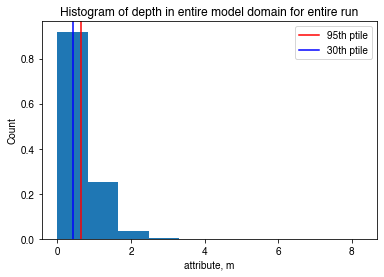

In [16]:
#plt.figure(figsize = (30, 20))
char = 10 ##### what do you want to colour by? flow depth (4), elevation change (7) etc
attribs = datamaster[:, char, :].ravel() # scaling to find your normalisation for the attribute/char you choose to colour with
avattribs = np.average(attribs)
locd = np.average(avattribs)
scd = np.std(avattribs)
attx = np.linspace(attribs.min(), attribs.max())
apdf = stats.norm.pdf(attx, locd, scd)
plt.hist(attribs, density=True);

toplim = np.quantile(attribs, 0.65)
lowlim = np.quantile(attribs, 0.45)
discrete_vel = np.quantile(attribs, (0.1, 0.25, 0.26, 0.99))
print(discrete_vel)
#plt.figure(figsize = (30, 20))
plt.axvline(toplim, c = 'r', label = '95th ptile')
plt.axvline(lowlim, c = 'b', label = '30th ptile')
plt.xlabel('attribute, m')
plt.ylabel('Count')
plt.legend()

plt.title('Histogram of depth in entire model domain for entire run');
print(f'attribute top: {np.round(toplim, 2)}. Midpoint: {np.round(lowlim, 2)}')

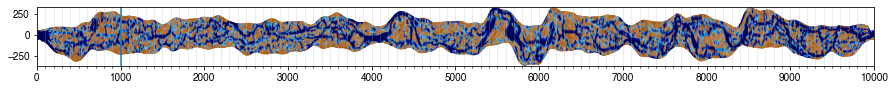

In [17]:
#create 2D grid
#extract elevation

xdomain = np.reshape(datamaster[:, 2, -1], (gridy, gridx))
ydomain = np.reshape(datamaster[ :, 3, -1] , (gridy, gridx))


#normalise = plt.Normalize(-1, 2)
#midnorm = MidpointNormalize(vmin=-np.quantile(datamaster[:, 4, :], 0.1), vcenter=0.5, vmax=np.quantile(datamaster[:, 4, :], 0.99))
#midnorm = MidpointNormalize(vmin=0, vcenter=np.quantile(datamaster[:, char, :], .25), vmax=np.quantile(datamaster[:, char, :], .999)) 
midnorm = MidpointNormalize(vmin=0, vcenter=lowlim, vmax=toplim) 

elev_final = np.reshape(datamaster[:, char, -1], (gridy, gridx)) ###using flow depth to plot
elev_pref = np.reshape(datamaster[:, char, pref_idx], (gridy, gridx)) ###using flow depth to plot
elev_postf = np.reshape(datamaster[:, char, post_idx], (gridy, gridx)) ###using flow depth to plot

plt.figure(figsize=(15, 2))
plt.pcolormesh(xdomain, ydomain, elev_final, cmap=get_continuous_cmap(test), norm = midnorm, shading='gouraud', alpha=0.7)
plt.axvline(xsloc)
ax = plt.gca()
ax.xaxis.set_minor_locator(MultipleLocator(100))
ax.xaxis.set_major_locator(MultipleLocator(1000))

ax.grid(axis = 'x', which = 'both', alpha = 0.3)
ax.set_aspect('equal')

Left bank max position:  241.882453863
Right bank max position:  -230.065536143
Shape of stratigraphy matrix:,  (382, 475)
True shape, m:  (382, 475) (382, 475) (382, 475) (382, 475) (382, 475)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.099911430184873 1.0
Left bank max position:  229.661005604
Right bank max position:  -218.784453811
Shape of stratigraphy matrix:,  (382, 451)
True shape, m:  (382, 451) (382, 451) (382, 451) (382, 451) (382, 451)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.5964615907966125 1.0
Left bank max position:  213.932155287
Right bank max position:  -200.976679857
Shape of stratigraphy matrix:,  (382, 418)
True shape, m:  (382, 418) (382, 418) (382, 418) (382, 418) (382, 418)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8136266342754808 1.0
Left bank max position:  171.579289018
Right bank max position:  -218.869306156
Shape of stratigraphy matrix:,  (382, 393)
True shape, m:  (382, 393) (382, 393) (382, 393) (382, 393) (382, 393)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.7331678917723998 1.0
Left bank max position:  179.346655764
Right bank max position:  -220.057556879
Shape of stratigraphy matrix:,  (382, 402)
True shape, m:  (382, 402) (382, 402) (382, 402) (382, 402) (382, 402)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.0467019794728165 1.0
Left bank max position:  127.827579692
Right bank max position:  -151.687610767
Shape of stratigraphy matrix:,  (382, 283)
True shape, m:  (382, 283) (382, 283) (382, 283) (382, 283) (382, 283)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9847801680234438 1.0
Left bank max position:  167.908127924
Right bank max position:  -176.027091931
Shape of stratigraphy matrix:,  (382, 347)
True shape, m:  (382, 347) (382, 347) (382, 347) (382, 347) (382, 347)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.0677371162512819 1.0
Left bank max position:  204.590255804
Right bank max position:  -166.790403792
Shape of stratigraphy matrix:,  (382, 374)
True shape, m:  (382, 374) (382, 374) (382, 374) (382, 374) (382, 374)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8958236642078324 1.0
Left bank max position:  185.720979779
Right bank max position:  -165.635368459
Shape of stratigraphy matrix:,  (382, 354)
True shape, m:  (382, 354) (382, 354) (382, 354) (382, 354) (382, 354)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.0904212009919216 1.0
Left bank max position:  195.814712604
Right bank max position:  -142.609473332
Shape of stratigraphy matrix:,  (382, 341)
True shape, m:  (382, 341) (382, 341) (382, 341) (382, 341) (382, 341)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.5809743707293219 1.0
Left bank max position:  215.648601431
Right bank max position:  -157.216597514
Shape of stratigraphy matrix:,  (382, 376)
True shape, m:  (382, 376) (382, 376) (382, 376) (382, 376) (382, 376)


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:170: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize = (12, 3), tight_layout=True)
/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


1.0019999999999997e-06
0.7770191533135022
-0.90876040644744 1.0
Left bank max position:  210.495379727
Right bank max position:  -160.061761115
Shape of stratigraphy matrix:,  (382, 374)
True shape, m:  (382, 374) (382, 374) (382, 374) (382, 374) (382, 374)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9327041952249367 1.0
Left bank max position:  228.271149717
Right bank max position:  -146.003448198
Shape of stratigraphy matrix:,  (382, 377)
True shape, m:  (382, 377) (382, 377) (382, 377) (382, 377) (382, 377)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8529655873209825 1.0
Left bank max position:  168.544306921
Right bank max position:  -134.463989513
Shape of stratigraphy matrix:,  (382, 306)
True shape, m:  (382, 306) (382, 306) (382, 306) (382, 306) (382, 306)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.042631855100829 1.0
Left bank max position:  136.368513356
Right bank max position:  -158.356111882
Shape of stratigraphy matrix:,  (382, 298)
True shape, m:  (382, 298) (382, 298) (382, 298) (382, 298) (382, 298)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8408821280937177 1.0
Left bank max position:  141.970842107
Right bank max position:  -235.350485207
Shape of stratigraphy matrix:,  (382, 380)
True shape, m:  (382, 380) (382, 380) (382, 380) (382, 380) (382, 380)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.434358330796077 1.0
Left bank max position:  135.502856947
Right bank max position:  -205.372550533
Shape of stratigraphy matrix:,  (382, 344)
True shape, m:  (382, 344) (382, 344) (382, 344) (382, 344) (382, 344)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8396376257123234 1.0
Left bank max position:  147.568747169
Right bank max position:  -219.90496569
Shape of stratigraphy matrix:,  (382, 370)
True shape, m:  (382, 370) (382, 370) (382, 370) (382, 370) (382, 370)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.5791196898494855 1.0
Left bank max position:  194.069886701
Right bank max position:  -214.856652176
Shape of stratigraphy matrix:,  (382, 412)
True shape, m:  (382, 412) (382, 412) (382, 412) (382, 412) (382, 412)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.1814263016463304 1.0
Left bank max position:  164.469789707
Right bank max position:  -221.305340518
Shape of stratigraphy matrix:,  (382, 389)
True shape, m:  (382, 389) (382, 389) (382, 389) (382, 389) (382, 389)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8233801505028631 1.0
Left bank max position:  157.559125944
Right bank max position:  -213.41379656
Shape of stratigraphy matrix:,  (382, 374)
True shape, m:  (382, 374) (382, 374) (382, 374) (382, 374) (382, 374)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9727705751299593 1.0
Left bank max position:  161.583754412
Right bank max position:  -187.539618931
Shape of stratigraphy matrix:,  (382, 352)
True shape, m:  (382, 352) (382, 352) (382, 352) (382, 352) (382, 352)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9387959269840098 1.0
Left bank max position:  152.726327214
Right bank max position:  -183.033476752
Shape of stratigraphy matrix:,  (382, 339)
True shape, m:  (382, 339) (382, 339) (382, 339) (382, 339) (382, 339)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8084641897556775 1.0
Left bank max position:  123.053205743
Right bank max position:  -126.612235793
Shape of stratigraphy matrix:,  (382, 253)
True shape, m:  (382, 253) (382, 253) (382, 253) (382, 253) (382, 253)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.0104950316604588 1.0
Left bank max position:  202.667800601
Right bank max position:  -150.612710282
Shape of stratigraphy matrix:,  (382, 356)
True shape, m:  (382, 356) (382, 356) (382, 356) (382, 356) (382, 356)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.956915102533663 1.0
Left bank max position:  224.166035831
Right bank max position:  -141.761213556
Shape of stratigraphy matrix:,  (382, 369)
True shape, m:  (382, 369) (382, 369) (382, 369) (382, 369) (382, 369)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.330530132049086 1.0
Left bank max position:  268.439794292
Right bank max position:  -147.940998688
Shape of stratigraphy matrix:,  (382, 419)
True shape, m:  (382, 419) (382, 419) (382, 419) (382, 419) (382, 419)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.7542385205600806 1.0
Left bank max position:  206.970744714
Right bank max position:  -157.002972991
Shape of stratigraphy matrix:,  (382, 367)
True shape, m:  (382, 367) (382, 367) (382, 367) (382, 367) (382, 367)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.826834239993077 1.0
Left bank max position:  172.385009716
Right bank max position:  -193.196717415
Shape of stratigraphy matrix:,  (382, 369)
True shape, m:  (382, 369) (382, 369) (382, 369) (382, 369) (382, 369)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.1976705652549355 1.0
Left bank max position:  152.202386808
Right bank max position:  -157.283946504
Shape of stratigraphy matrix:,  (382, 312)
True shape, m:  (382, 312) (382, 312) (382, 312) (382, 312) (382, 312)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9572321249269896 1.0
Left bank max position:  126.356874681
Right bank max position:  -106.831046964
Shape of stratigraphy matrix:,  (382, 236)
True shape, m:  (382, 236) (382, 236) (382, 236) (382, 236) (382, 236)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8720870565784798 1.0
Left bank max position:  101.017207671
Right bank max position:  -85.4045196671
Shape of stratigraphy matrix:,  (382, 189)
True shape, m:  (382, 189) (382, 189) (382, 189) (382, 189) (382, 189)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.7361243983899761 1.0
Left bank max position:  146.199425012
Right bank max position:  -103.59917847
Shape of stratigraphy matrix:,  (382, 253)
True shape, m:  (382, 253) (382, 253) (382, 253) (382, 253) (382, 253)
1.0019999999999997e-06
0.7770191533135022
-1.2873776599262947 1.0
Left bank max position:  256.041182261
Right bank max position:  -146.937798622
Shape of stratigraphy matrix:,  (382, 406)
True shape, m:  (382, 406) (382, 406) (382, 406) (382, 406) (382, 406)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.8419935044022488 1.0
Left bank max position:  276.59354291
Right bank max position:  -160.809727587
Shape of stratigraphy matrix:,  (382, 440)
True shape, m:  (382, 440) (382, 440) (382, 440) (382, 440) (382, 440)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.175589473294777 1.0
Left bank max position:  223.262856194
Right bank max position:  -159.402921527
Shape of stratigraphy matrix:,  (382, 386)
True shape, m:  (382, 386) (382, 386) (382, 386) (382, 386) (382, 386)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.6672165542995941 1.0
Left bank max position:  202.393778726
Right bank max position:  -210.133656118
Shape of stratigraphy matrix:,  (382, 416)
True shape, m:  (382, 416) (382, 416) (382, 416) (382, 416) (382, 416)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.5024451400317804 1.0
Left bank max position:  173.467972085
Right bank max position:  -193.673975773
Shape of stratigraphy matrix:,  (382, 370)
True shape, m:  (382, 370) (382, 370) (382, 370) (382, 370) (382, 370)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.0583694302530222 1.0
Left bank max position:  150.391291584
Right bank max position:  -147.642160156
Shape of stratigraphy matrix:,  (382, 301)
True shape, m:  (382, 301) (382, 301) (382, 301) (382, 301) (382, 301)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9022171722575085 1.0
Left bank max position:  158.736229783
Right bank max position:  -174.367768984
Shape of stratigraphy matrix:,  (382, 336)
True shape, m:  (382, 336) (382, 336) (382, 336) (382, 336) (382, 336)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.940077023026595 1.0
Left bank max position:  160.650626749
Right bank max position:  -213.128694169
Shape of stratigraphy matrix:,  (382, 377)
True shape, m:  (382, 377) (382, 377) (382, 377) (382, 377) (382, 377)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.6943509286941255 1.0
Left bank max position:  157.823152499
Right bank max position:  -226.630151918
Shape of stratigraphy matrix:,  (382, 387)
True shape, m:  (382, 387) (382, 387) (382, 387) (382, 387) (382, 387)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9060169877762038 1.0
Left bank max position:  139.743724717
Right bank max position:  -232.029015846
Shape of stratigraphy matrix:,  (382, 375)
True shape, m:  (382, 375) (382, 375) (382, 375) (382, 375) (382, 375)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.5055996489699286 1.0
Left bank max position:  138.299015514
Right bank max position:  -206.902886045
Shape of stratigraphy matrix:,  (382, 348)
True shape, m:  (382, 348) (382, 348) (382, 348) (382, 348) (382, 348)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.7529358270721285 1.0
Left bank max position:  232.476158394
Right bank max position:  -125.068879018
Shape of stratigraphy matrix:,  (382, 361)
True shape, m:  (382, 361) (382, 361) (382, 361) (382, 361) (382, 361)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.2690783663422918 1.0
Left bank max position:  324.843636528
Right bank max position:  -112.330729003
Shape of stratigraphy matrix:,  (382, 440)
True shape, m:  (382, 440) (382, 440) (382, 440) (382, 440) (382, 440)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.5796014613613384 1.0
Left bank max position:  299.499321748
Right bank max position:  -86.6300654456
Shape of stratigraphy matrix:,  (382, 389)
True shape, m:  (382, 389) (382, 389) (382, 389) (382, 389) (382, 389)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9123756755540992 1.0
Left bank max position:  235.314422501
Right bank max position:  -157.888294634
Shape of stratigraphy matrix:,  (382, 396)
True shape, m:  (382, 396) (382, 396) (382, 396) (382, 396) (382, 396)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.1864378322657196 1.0
Left bank max position:  129.634797148
Right bank max position:  -344.86752257
Shape of stratigraphy matrix:,  (382, 478)
True shape, m:  (382, 478) (382, 478) (382, 478) (382, 478) (382, 478)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9635157834974998 1.0
Left bank max position:  106.89599606
Right bank max position:  -345.163736551
Shape of stratigraphy matrix:,  (382, 455)
True shape, m:  (382, 455) (382, 455) (382, 455) (382, 455) (382, 455)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.5562523422070117 1.0
Left bank max position:  113.354783818
Right bank max position:  -368.130758117
Shape of stratigraphy matrix:,  (382, 484)
True shape, m:  (382, 484) (382, 484) (382, 484) (382, 484) (382, 484)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8804501149204047 1.0
Left bank max position:  222.448306269
Right bank max position:  -219.770168348
Shape of stratigraphy matrix:,  (382, 445)
True shape, m:  (382, 445) (382, 445) (382, 445) (382, 445) (382, 445)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.570246396746654 1.0
Left bank max position:  323.244873994
Right bank max position:  -162.869126373
Shape of stratigraphy matrix:,  (382, 489)
True shape, m:  (382, 489) (382, 489) (382, 489) (382, 489) (382, 489)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9331810427608469 1.0
Left bank max position:  282.886052569
Right bank max position:  -186.411851068
Shape of stratigraphy matrix:,  (382, 472)
True shape, m:  (382, 472) (382, 472) (382, 472) (382, 472) (382, 472)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.5569307730771325 1.0
Left bank max position:  268.700562518
Right bank max position:  -183.002347729
Shape of stratigraphy matrix:,  (382, 455)
True shape, m:  (382, 455) (382, 455) (382, 455) (382, 455) (382, 455)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.3535811849994979 1.0
Left bank max position:  229.174826742
Right bank max position:  -167.707207782
Shape of stratigraphy matrix:,  (382, 400)
True shape, m:  (382, 400) (382, 400) (382, 400) (382, 400) (382, 400)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8721245297212221 1.0
Left bank max position:  217.398615138
Right bank max position:  -213.211153549
Shape of stratigraphy matrix:,  (382, 434)
True shape, m:  (382, 434) (382, 434) (382, 434) (382, 434) (382, 434)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8891094335955351 1.0
Left bank max position:  219.368214434
Right bank max position:  -207.534595129
Shape of stratigraphy matrix:,  (382, 430)
True shape, m:  (382, 430) (382, 430) (382, 430) (382, 430) (382, 430)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.0049651764617689 1.0
Left bank max position:  235.658123195
Right bank max position:  -239.189788819
Shape of stratigraphy matrix:,  (382, 478)
True shape, m:  (382, 478) (382, 478) (382, 478) (382, 478) (382, 478)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.157966591371913 1.0
Left bank max position:  232.404564459
Right bank max position:  -204.379726713
Shape of stratigraphy matrix:,  (382, 440)
True shape, m:  (382, 440) (382, 440) (382, 440) (382, 440) (382, 440)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9272805403900152 1.0
Left bank max position:  179.469828502
Right bank max position:  -132.16537551
Shape of stratigraphy matrix:,  (382, 315)
True shape, m:  (382, 315) (382, 315) (382, 315) (382, 315) (382, 315)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.2947993833226774 1.0
Left bank max position:  111.778052288
Right bank max position:  -118.050663964
Shape of stratigraphy matrix:,  (382, 233)
True shape, m:  (382, 233) (382, 233) (382, 233) (382, 233) (382, 233)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.657862968730063 1.0
Left bank max position:  154.464787487
Right bank max position:  -227.511999632
Shape of stratigraphy matrix:,  (382, 385)
True shape, m:  (382, 385) (382, 385) (382, 385) (382, 385) (382, 385)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8266400006993122 1.0
Left bank max position:  177.168947679
Right bank max position:  -256.688288426
Shape of stratigraphy matrix:,  (382, 437)
True shape, m:  (382, 437) (382, 437) (382, 437) (382, 437) (382, 437)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.4238418017570431 1.0
Left bank max position:  157.824020666
Right bank max position:  -274.482277808
Shape of stratigraphy matrix:,  (382, 435)
True shape, m:  (382, 435) (382, 435) (382, 435) (382, 435) (382, 435)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9938502485710794 1.0
Left bank max position:  163.297737537
Right bank max position:  -254.747497375
Shape of stratigraphy matrix:,  (382, 421)
True shape, m:  (382, 421) (382, 421) (382, 421) (382, 421) (382, 421)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.7370423389907544 1.0
Left bank max position:  218.735265842
Right bank max position:  -156.650060278
Shape of stratigraphy matrix:,  (382, 378)
True shape, m:  (382, 378) (382, 378) (382, 378) (382, 378) (382, 378)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8427249373131822 1.0
Left bank max position:  242.135776359
Right bank max position:  -135.897427957
Shape of stratigraphy matrix:,  (382, 381)
True shape, m:  (382, 381) (382, 381) (382, 381) (382, 381) (382, 381)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.6521627150803151 1.0
Left bank max position:  208.524053367
Right bank max position:  -187.706818126
Shape of stratigraphy matrix:,  (382, 399)
True shape, m:  (382, 399) (382, 399) (382, 399) (382, 399) (382, 399)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.0117473639059926 1.0
Left bank max position:  234.390205988
Right bank max position:  -287.735495218
Shape of stratigraphy matrix:,  (382, 525)
True shape, m:  (382, 525) (382, 525) (382, 525) (382, 525) (382, 525)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.5140356540067912 1.0
Left bank max position:  238.981489528
Right bank max position:  -295.132060132
Shape of stratigraphy matrix:,  (382, 537)
True shape, m:  (382, 537) (382, 537) (382, 537) (382, 537) (382, 537)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.079424103417843 1.0
Left bank max position:  189.904138991
Right bank max position:  -270.01318017
Shape of stratigraphy matrix:,  (382, 463)
True shape, m:  (382, 463) (382, 463) (382, 463) (382, 463) (382, 463)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.6047655708723222 1.0
Left bank max position:  158.386500165
Right bank max position:  -267.020157516
Shape of stratigraphy matrix:,  (382, 428)
True shape, m:  (382, 428) (382, 428) (382, 428) (382, 428) (382, 428)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.253771228923822 1.0
Left bank max position:  115.975470699
Right bank max position:  -239.359220287
Shape of stratigraphy matrix:,  (382, 358)
True shape, m:  (382, 358) (382, 358) (382, 358) (382, 358) (382, 358)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9702460694324293 1.0
Left bank max position:  114.951649845
Right bank max position:  -130.084402283
Shape of stratigraphy matrix:,  (382, 248)
True shape, m:  (382, 248) (382, 248) (382, 248) (382, 248) (382, 248)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-2.501542627441164 1.0
Left bank max position:  316.897532562
Right bank max position:  -130.454691229
Shape of stratigraphy matrix:,  (382, 450)
True shape, m:  (382, 450) (382, 450) (382, 450) (382, 450) (382, 450)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-1.4165151576104562 1.0
Left bank max position:  306.830003604
Right bank max position:  -147.281636434
Shape of stratigraphy matrix:,  (382, 457)
True shape, m:  (382, 457) (382, 457) (382, 457) (382, 457) (382, 457)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.8069754641547945 1.0
Left bank max position:  295.170944092
Right bank max position:  -152.419691043
Shape of stratigraphy matrix:,  (382, 451)
True shape, m:  (382, 451) (382, 451) (382, 451) (382, 451) (382, 451)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9467752803614906 1.0
Left bank max position:  284.725196774
Right bank max position:  -139.647884337
Shape of stratigraphy matrix:,  (382, 427)
True shape, m:  (382, 427) (382, 427) (382, 427) (382, 427) (382, 427)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9864200023822702 1.0
Left bank max position:  213.098377146
Right bank max position:  -135.587323329
Shape of stratigraphy matrix:,  (382, 352)
True shape, m:  (382, 352) (382, 352) (382, 352) (382, 352) (382, 352)
1.0019999999999997e-06
0.7770191533135022


/var/folders/yg/89nlrh5x2xzgdlgr2bczm4_m0000gn/T/ipykernel_17058/54744127.py:216: RuntimeWarning: invalid value encountered in log10
  chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?


-0.9481285474984185 1.0


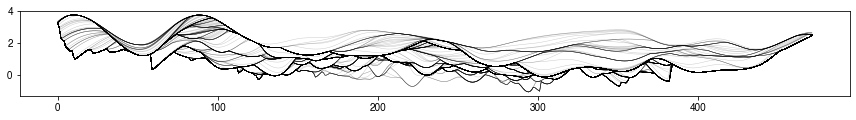

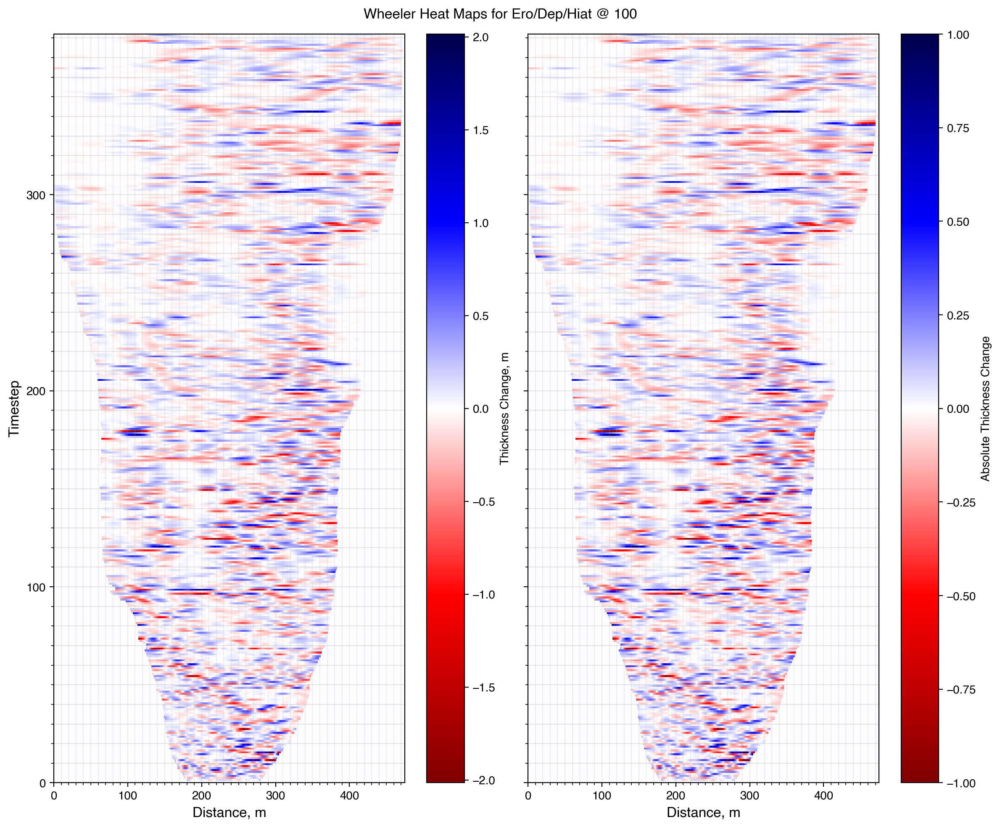

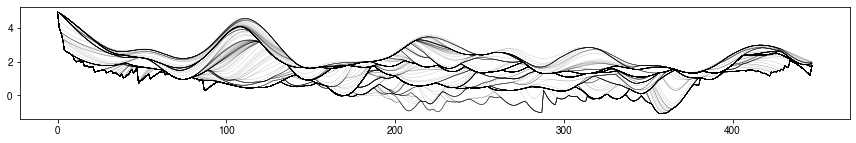

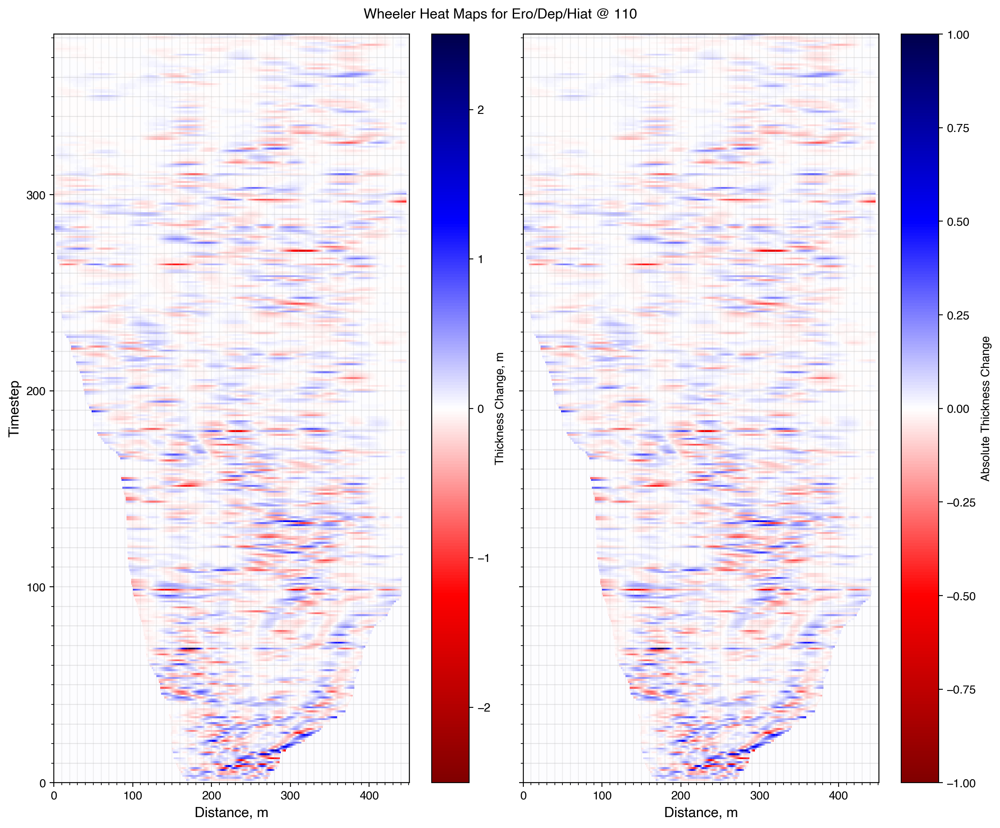

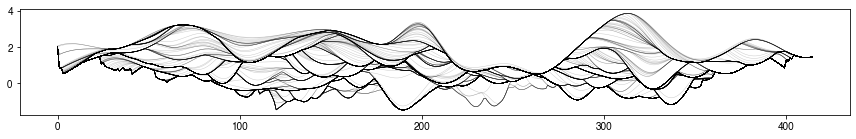

...

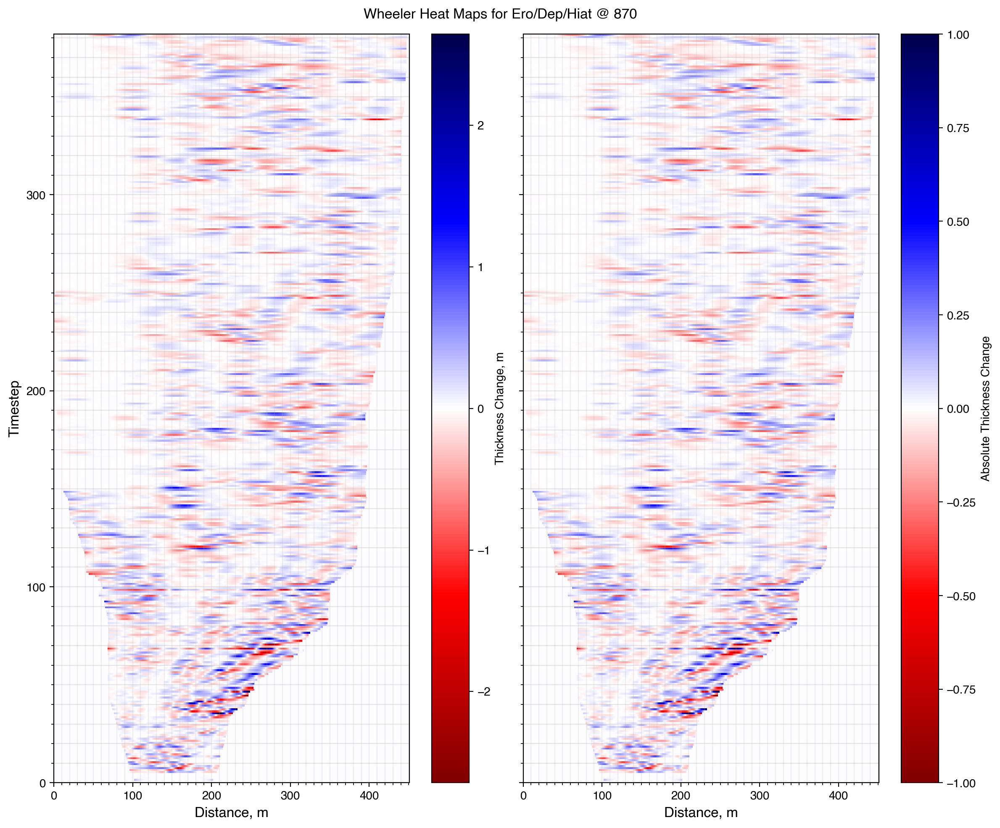

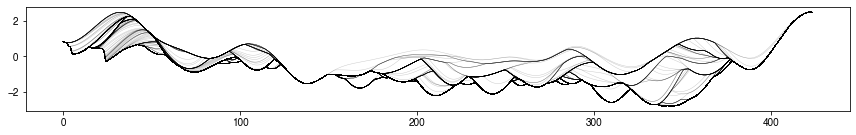

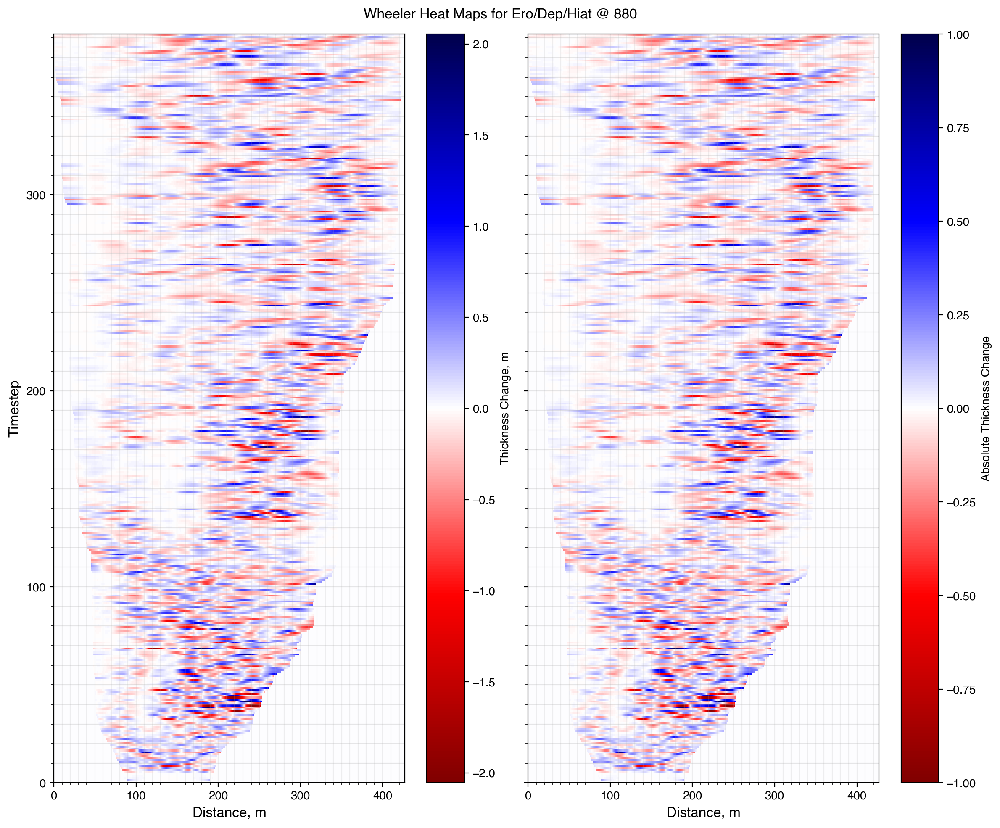

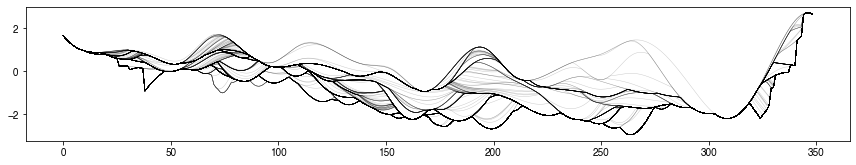

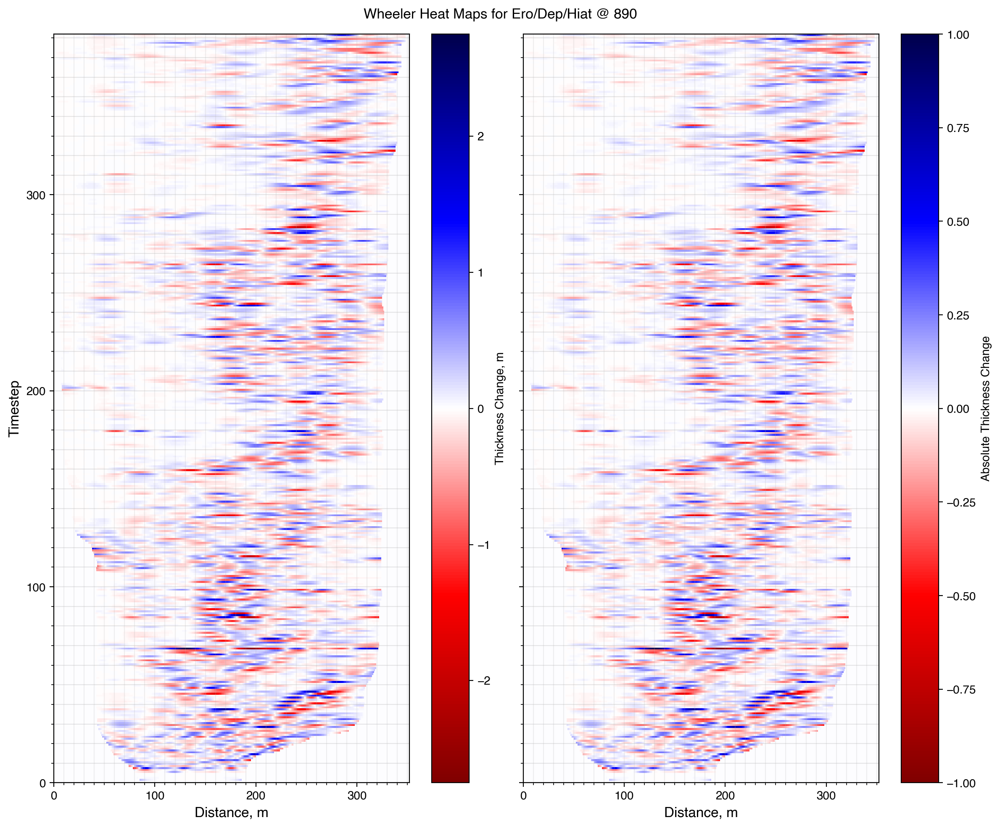

In [22]:
ilocation = np.arange(100, 900, 10)
for iloc in ilocation:
    modelrun = f'{nickname}-{idf}-{iloc}'

    remove_ilocs = np.where(datamaster[:, 0, :] != iloc)
    data = np.delete(datamaster, remove_ilocs[0], axis=0)
    for i in range (0, num_timesteps):
        data[:, :, i] = data[:, :, i][np.argsort(data[:, :, i][:, 3])]
    stratigraphy = np.empty([end_t, cells]) ###will hold data for topography accounting for changes due to erosion

    stratigraphy_idx = stratigraphy.copy()

    shearstresseroded = stratigraphy.copy() #will hold data for shear stress accounting for changes due to erosion

    stratflowdepth =  stratigraphy.copy() #will hold data for flow depth accounting for changes due to erosion

    scaleflowdepth =  stratigraphy.copy() #will hold data for local flow depth scaled to max accounting for changes due to erosion

    froudedata =  stratigraphy.copy() #will hold data for local flow depth scaled to max accounting for changes due to erosion

    velocity =  stratigraphy.copy()
    runtime = len(stratigraphy)
    #print(runtime)
    xposition =  stratigraphy.copy()

    in_section = np.where(datamaster[:, 0, -1]==iloc)
    in_section = in_section[0]
    bankpos = datamaster[:, 3, :][in_section]
    #print(bankpos)
    rightbank = bankpos.min() ###negativee
    leftbank = bankpos.max() #positive
    print('Left bank max position: ', leftbank)
    print('Right bank max position: ', rightbank)

    xy_strat = np.empty([end_t, int(3+np.round((leftbank-rightbank)/spacing, 0))]) # will put stratigraphies here, in proper x pos
    print('Shape of stratigraphy matrix:, ', xy_strat.shape)
    xy_strat[:] = np.nan

    for time in range (0, data.shape[2]): #TIME
        #print(stratigraphy[time, :].shape)
        stratigraphy[time, :] = data[:, 7, time] #elevation change, elevation in 5
        shearstresseroded[time, :] = data[:, 6, time] 
        stratflowdepth[time, :] = data[:, 4, time]
        froudedata[time, :] = data[:, 9, time]
        velocity[time, :] = data[:, 10, time]

        ypos = data[:, 3, time]-rightbank #coreect supid centreline indexing
        #print(ypos)
        xposition[time, :] = ypos

    stratigraphy_idx = stratigraphy.copy()

    ##### these arrays will house interpolated data
    shear = xy_strat.copy()
    froude = xy_strat.copy()
    scaleflow = xy_strat.copy() #flow depth scaled to max per time
    trueflow = xy_strat.copy() #unscaled flow depth
    flowvel = xy_strat.copy() #flow velocity

    print('True shape, m: ', shear.shape, froude.shape, scaleflow.shape, trueflow.shape, flowvel.shape)

    #put all data values in their correct x/index position
    for t in range (0, end_t):
        #print(t)
        for idx, x in zip(np.arange(0, stratigraphy.shape[1]), xposition[t, :]):
            #print(x)
            #print(idx, x)
            x = int(np.floor(x)) #rounding down positions, making integers so can use as index
            #print(x, idx)
            xy_strat[t, x] = stratigraphy[t, idx]
            shear[t, x] = shearstresseroded[t, idx]
            froude[t, x] = froudedata[t, idx]
            trueflow[t, x] = stratflowdepth[t, idx]
            scaleflow[t, x] = scaleflowdepth[t, idx]
            flowvel[t, x] = velocity[t, idx]
        #plt.plot(xy_strat[t, :], '.')

    xy_topo = np.empty_like(xy_strat)
    xy_topo[:] = np.nan
    for t in range (0, end_t):
        #print(t)
        length = int(np.floor(xposition[t, -1]-xposition[t, 0])) #length of the section at time, t
        pos = np.linspace(0, length, length) #create a metre scale array with each x pos = location
        #dataint = np.linspace(int(np.round(xposition[t, 0], 0)), int(np.round(xposition[t, -1], 0)), length, dtype=int) #range of locations to interpolate over?
        dataint = np.arange(xposition[t, 0], np.round(xposition[t, -1], 0), dtype=int)
        #print(t, pos.max(), length)
        #print(len(dataint))
        #print(pos)

        stratnotnan = xy_strat[t, :][~np.isnan(xy_strat[t, :])] #pull out real values of strat
        shearnotnan = shear[t, :][~np.isnan(shear[t, :])] #pull out real values of shear
        froudenotnan = froude[t, :][~np.isnan(froude[t, :])] #pull out real values of froude
        truefnotnan = trueflow[t, :][~np.isnan(trueflow[t, :])] #pull out real values of true flow depth
        #scalefnotnan = scaleflow[t, :][~np.isnan(scaleflow[t, :])] #pull out real values of scaled flow depth
        velnotnan = flowvel[t, :][~np.isnan(flowvel[t, :])] #pull out real values of strat
        #print(shear[t, :][~np.isnan(shear[t, :])])
        #print(shearnotnan[:].shape, froudenotnan[:].shape, truefnotnan[:].shape, velnotnan[:].shape)
        #print(xposition[t, :])
        #print(dataint)
        fx = interpolate.interp1d(xposition[t, :], stratnotnan[:], kind = 'cubic', fill_value = 'extrapolate') #stratigraphy interpolation
        #print(fx)
        fsh = interpolate.interp1d(xposition[t, :], shearnotnan[:], kind = 'cubic', fill_value = 'extrapolate') #shear stress interpolation
        ffr = interpolate.interp1d(xposition[t, :], froudenotnan[:], kind = 'cubic', fill_value = 'extrapolate') #froude number interpolation
        ftf = interpolate.interp1d(xposition[t, :], truefnotnan[:], kind = 'cubic', fill_value = 'extrapolate') #true flow depth interpolation
        #fsf = interpolate.interp1d(xposition[t, :], scalefnotnan[:], kind = 'cubic') #scaled flow depth interpolation
        ffv = interpolate.interp1d(xposition[t, :], velnotnan[:], kind = 'cubic', fill_value = 'extrapolate') #flow veloity interpolation

        #print(fx(dataint))

        xy_topo[t, dataint] = fx(dataint) #reassign strat
        #print(xy_topo[t, :])
        shear[t, dataint] = fsh(dataint) #reassign shear
        froude[t, dataint] = ffr(dataint) #reassign froude
        trueflow[t, dataint] = ftf(dataint) #reassign true fd
        #scaleflow[t, 0:length] = fsf(pos) #reassign scaled fd
        flowvel[t, dataint] = ffv(dataint) #reassign flow vel

        #plt.plot(xy_topo[t, :])
    #plt.ylim(-3, 3)

    #each of these conditional arrays have a border of nans to helo pick out the 'packages'
    stratcondition = np.zeros_like(xy_topo)
    stratcondition[:] = np.nan
    ages = np.empty_like(xy_strat)


    erosurf = np.empty([end_t, xy_topo.shape[1]])
    erosurf[:] = np.nan

    strat = copy.deepcopy(xy_topo)

    halfwidth=25

    for time in range (0, end_t):

        for space in range (0, xy_topo.shape[1]):
            #print(space)
            preexisting_strata = xy_topo[:time, :] #this is our search array, where we will erode
            willerode = np.where(preexisting_strata[:, space] > xy_topo[time, space])
            xy_topo[willerode, space] = xy_topo[time, space]
            ages[willerode, space] = time

    if sec_flag == 'XS':
        for i in range (end_t-2, -1, -1):

            fillinx = np.where(np.isnan(xy_topo[i, :]))
            xy_topo[i, fillinx] = xy_topo[i+1, fillinx]
            stratcondition[i, fillinx] = 1
            #print(stratcondition[i, fillinx])

            fillinsh = np.where(np.isnan(shear[i, :]))
            shear[i, fillinsh] = shear[i+1, fillinsh]

            fillinfr = np.where(np.isnan(froude[i, :]))
            froude[i, fillinfr] = froude[i+1, fillinfr]

            fillintf = np.where(np.isnan(trueflow[i, :]))
            trueflow[i, fillintf] = trueflow[i+1, fillintf]

            fillinsf = np.where(np.isnan(scaleflow[i, :]))
            scaleflow[i, fillinsf] = scaleflow[i+1, fillinsf]

            fillinfv = np.where(np.isnan(flowvel[i, :]))
            flowvel[i, fillinfv] = flowvel[i+1, fillinfv]

            fillinstrat = np.where(np.isnan(strat[i, :]))


    #%matplotlib notebook
    fig, ax = plt.subplots(figsize = (12, 3), tight_layout=True)
    for i in range(0, end_t):
        ax.plot(xy_topo[i, :], 'k', alpha = 0.2, lw = 0.5)
    ax.set_aspect('10')

    maxflow = np.reshape(np.nanmax(trueflow, axis=1), [end_t, 1]) ## max flow across the section at each timestep
    scaleflow = trueflow/maxflow

    # fig, ax = plt.subplots(1, 2, figsize= (14, 6), tight_layout = True)
    # ax[0].hist(trueflow.ravel(), **kwargs)
    flowdep = np.mean(trueflow)

    # for i in range (0, end_t):
    #     ax[1].plot(i, np.nanmin(trueflow[i, :]), marker = 'v', ms = '2', mec = 'xkcd:grey', mfc = 'r')
    #     ax[1].plot(i, np.nanmax(trueflow[i, :]), marker = '^', ms = '2', mec = 'b', mfc = 'b')
    #     ax[1].plot(i, np.nanmean(trueflow[i, :]), marker = '.', ms = '5', mec = 'k', mfc = 'k')

    # ax[1].set_title('Time Series of Flow Depth at XS\n blue = max, grey = min, black = mean') 
    # ax[0].set_title('Distribution of flow depth at section')
    # ax[0].set_ylabel('Count')
    # ax[0].set_xlabel('Flow Depth, m')

    # ax[1].set_ylabel('Flow Depth, m')
    # ax[1].set_xlabel('Timestep, 2hours')

    # ax[1].axvline(fldstart, c='r', ls = '--');
    # ax[1].axvline(fldstart+(fldlength/interval_to_plot), c='r', ls = '--');

    # # plt.close(fig)

    # #### Set up the grids for plotting and facies modelling

    start_time = 0 #would be start of model run
    end_time = end_t #would be end of model run

    tim = range(start_time,end_time) #range of time

    position = np.arange(0, xy_topo.shape[1], dtype = float)

    ## mobility parameter from van den berg and van gelder 1993
    temp = 20.0 #temperature in degrees celcius
    kv = (1.14-0.031*(temp-15)+0.00068*((temp-15)**2))*10**-6
    print(kv)
    D_star = np.power((1.65*9.81)/(1e3*(kv**2)), 0.333)*3.1e-4
    print(D_star)
    d50um = 310
    chezy_rough = 18*(np.log10(4*trueflow/d50)) #i think this is log10, else they would've put ln no?

    mmp =(p*(flowvel**2))/(1650*(chezy_rough**2)*d50)##### modified mobility parameter
    mmprange = [0.01, 0.025, 0.17, 0.35, 1.5, 10] ##### LP, R, D, D-UP, UP

    # Set up plotting cmaps

    # Make a user-defined colormap.
    cm1 = mycmap
    cnorm = mcol.Normalize(vmin=min(tim),vmax=max(tim))

    # Turn these into an object that can be used to map time values to colors and can be passed to plt.colorbar().
    cpick = cm.ScalarMappable(norm=cnorm,cmap=timesteps_r) 
    cpick.set_array([])

    # ##### comparing van den berg and van gelder facies
    # mud brown = LSPB vv
    # dirt = ripples vv sb
    # sandy brown = dunes vv sb
    # tan = D-UPSB vv
    # beige = UPSB vv sb
    # stone = super high (antidunes, extra) vv sb

    cmap_vvfac = ListedColormap(['xkcd:mud brown', 'xkcd:shit', 'xkcd:dark tan', 'xkcd:sand', 'xkcd:stone'])
    #mmprange = [0.01, 0.025, 0.17, 0.35, 1.5, 10] ##### LP, R, D, D-UP, UP
    norm_vvfac = BoundaryNorm(mmprange, cmap_vvfac.N)

    #### Create erosional, depositional and hiatal surfaces

    ages_ero = np.empty_like(xy_topo)
    posnew = np.arange(0, xy_topo.shape[1])
    
    hiatal_scenario = 2

    threshold_thick = 0.005  #absolute value in metres 

    nth = 25 #what percentile distribution to use to calculate hiatal surfaces for each timestep
    perc = 0.1 #fraction of percentile


    for time in range (1, end_t):
        #print(time)
        ages_ero[time, :] = time 
        #stratinterpcub[time, :] = topointerp[time, :]

        lessthan = np.where(strat[time, :] < xy_topo[time-1, :]) ###where it erodes
        #print(lessthan)
        ele_change = strat[time, :]-xy_topo[time-1, :] #find the bed elevation change across the domain
                                                                       #it has to be before you reassign topography else 

        ages_ero[time, lessthan] = ages_ero[time-1, lessthan]


        if hiatal_scenario == 1:
            threshold_thick = perc*(np.nanmean(ele_change)) #find the fraction of the average elevation change between the two latest timesteps

        if hiatal_scenario == 2:
            threshold_thick = perc*np.nanpercentile(ele_change, nth)

        if time != 0:
            hiatus_idx = np.where(abs(ele_change) < abs(threshold_thick))

            ages_ero[time, hiatus_idx] = ages_ero[time-1, hiatus_idx]
            #print(ages_ero[time, :])
    ages_ero[-1, :] = end_t
    #        print(ages_ero)


    deposurf = erosurf.copy()
    hiatalsurf = erosurf.copy()
    erohiatalsurf = erosurf.copy()
    time_of_ero = erosurf.copy()


    thickness = np.zeros_like(xy_topo)

    # fig, ax = plt.subplots(2, 3, figsize = (19.80, 10.8), tight_layout = True)#, sharey = True, sharex = True)#, sharex = True, sharey = True)

    for time in range (1, end_t):


        #ax[0,0].plot(posnew, topointerp[time], color=cpick.to_rgba(time))
        thickness[time, :] = strat[time, :]-strat[time-1, :]
        thickness[time, :][np.isnan(thickness[time, :])] = 0
        #print(thickness[time, :])
        # ax[0,1].plot(time, thickness[time, :].max(), marker = 'o', mew = 0, markerfacecolor = 'xkcd:cobalt blue')
        # ax[0,1].plot(time, thickness[time, :].min(), marker = 'o', mew = 0, markerfacecolor = 'xkcd:green yellow')
        # ax[0,1].plot(time, np.average(thickness[time, :]), marker = 'o', mew = 0, markerfacecolor = 'xkcd:coral')

        if hiatal_scenario == 1:
                #using a percentage of the average thickness to constrain hiatal surfaces
            threshold_thick = perc*(np.mean(thickness[time, :]))  #x% of the average sediment thickness at x time. may be negative.
        elif hiatal_scenario == 2:
                #using nth percentile of the thicknesses at each timestep
            threshold_thick = perc*np.percentile(abs(thickness[time, :]), nth) #find the nth percentile of depositon at x time. positive number.

#         ax[0,0].plot(time, threshold_thick, 'o', markerfacecolor = cpick.to_rgba(time), markeredgecolor = cpick.to_rgba(time), linewidth = 0.0001, markersize = 14, alpha = 0.5)


#         ax[0,0].set_ylim(-0.05, .05)
#         #print('10th', np.percentile(abs(thickness), nth), 'thresh', threshold_thick)

        hiatalwhere = np.where(abs(thickness[time, :]) < threshold_thick) #where elev change is less than 10% avg
        depositingwhere = np.where(thickness[time, :] > threshold_thick)
        erodingwhere = np.where(thickness[time, :] < -abs(threshold_thick))
        #print(time, depositing where)

        stratcondition[time, depositingwhere] = 0
        stratcondition[time, erodingwhere] = 1
        stratcondition[time, hiatalwhere] = 2
        erodereset = np.where(stratcondition[time, :]==1)

        erosurf[time, erodereset] = xy_topo[time, erodereset]
        deposurf[time, depositingwhere] = xy_topo[time, depositingwhere]
        hiatalsurf[time, hiatalwhere] = xy_topo[time, hiatalwhere]
        erohiatalsurf[time, erodereset] = xy_topo[time, erodereset]
        erohiatalsurf[time, hiatalwhere] = xy_topo[time, hiatalwhere]


#     sums = np.zeros_like(xy_topo)
#     #sums = np.delete(sums, 0, axis=0)
#     for cols in range (0, sums.shape[1]):
#         uniques = np.unique(ages_ero[1:, cols]) ###find the unique ages in the ages matrix
#         for ul, uu  in zip(uniques[:-1], uniques[1:]):
#             clip = int((uu-ul))
#             #print(clip, uu, ul)
#             change = np.where(ages_ero[:, cols]==ul)[0].astype(int)
#             st = change[0]
#             sums[st:st+clip, cols] = np.arange(0, clip)

    ### MAKE PLOTS

    start_time = 0 #would be start of model run
    end_time_int = num_timesteps-1 #would be end of model run

    tim_int = range(start_time,end_time) #range of time
    xdat_int = posnew #position
    ydat_int = [xy_topo[t] for t in tim_int] #stratigraphy/elevation @ position

    #with plt.style.context('dark_background'):
    fig, (ax1, ax2, ax4) = plt.subplots(3, 1, sharex=True, sharey=True, squeeze = True, tight_layout=True, figsize=(38.40/3,  21.60/3), dpi = 300)
    fig.subplots_adjust(hspace=.05)


    for strata in range (0, end_t):

        ax1.set_xlim((posnew.min(), posnew.max())) #braided test
        #ax1.set_xlim((4000, 5000))
        #ax1.set_ylim((-2.5, 2.5))
        ax1.set_ylim(np.nanmin(xy_topo), np.nanmax(xy_topo)) #braided test

        ################## PULL THE DATA OUT FOR EACH TIMESTEP

        elevint = xy_topo[strata]
        shearstressint = shear[strata]
        depthint = scaleflow[strata]
        actualdepth = trueflow[strata]*flowvel[strata] #we do not want scaled flow depth for the facies
        cellularQ = trueflow[strata]#*flowvel[strata] 
        velint = flowvel[strata]
        #transportstage = Tparam[strata]
        vvfacies = mmp[strata] #van den berg and van gelder

        pointsint = np.array([posnew, elevint]).T.reshape(-1, 1, 2)
        segmentsint = np.concatenate([pointsint[:-1], pointsint[1:]], axis=1)

        ################## SET UP THE NORMALISATION

        sheargradint = plt.Normalize(np.nanmin(shear), np.nanmax(shear)) #bed shear based on skin friction for anti dunes = 4.410)
        cellQint = plt.Normalize(np.nanmin(cellularQ), np.nanmax(cellularQ))
        depth_quant = plt.Normalize(np.nanmin(depthint), np.nanquantile(trueflow, 0.95))
        velogradint = plt.Normalize(np.nanmin(velint), np.nanmax(velint)) ###gradient plot for flow velocity
        acdepth = plt.Normalize(np.nanmin(actualdepth), np.nanmax(actualdepth)) #normalistion with the aactual flow depth
        shear_quant = plt.Normalize(np.nanmin(shear), np.nanquantile(shear, 0.99)) #normalising ot shear stress max 99th ptile bc 10 is too high
        #transport = plt.Normalize(np.nanmin(transportstage), np.nanmax(transportstage)) ###gradient plot for flow velocity
        ######----Not actually cellular discharge, this is flow depth
        cellularQint = LineCollection(segmentsint, cmap=plt.get_cmap(depths), norm=cellQint)
        cellularQint.set_array(cellularQ)
        cellularQint.set_linewidth(1.5)

        cellularQline = ax2.add_collection(cellularQint)

        #-------- DOUBLE PLOT OF VELOCITY/FLOW DEPTH AND SHEAR STRESS
    #    vel_mix = LineCollection(segmentsint, cmap=get_continuous_cmap(redyellow), norm=velogradint)
        vel_mix = LineCollection(segmentsint, cmap='Reds', norm=velogradint)
        vel_mix.set_array(velint)
        vel_mix.set_linewidth(1.5)

        vel_mix_line = ax1.add_collection(vel_mix)

        vvfac = LineCollection(segmentsint, cmap = cmap_vvfac, norm = norm_vvfac)
        vvfac.set_array(vvfacies)
        vvfac.set_linewidth(1.5)
        vvfac_line = ax4.add_collection(vvfac)


    # if variabd == 1:
    #     ax1.plot(xy_topo[pref_idx], 'r--', lw = 3)
    #     ax2.plot(xy_topo[pref_idx], 'r--', lw = 3)
    # #   ax3.plot(xy_topo[pref_idx], 'r--', lw = 3)
    #     ax4.plot(xy_topo[pref_idx], 'r--', lw = 3)


    # ax1.set_facecolor('xkcd:midnight blue')
    # ax2.set_facecolor('xkcd:midnight blue')
    # #ax3.set_facecolor('xkcd:grey')
    # ax4.set_facecolor('xkcd:midnight blue')

    # ax4.set_xlabel('Cross stream distance, m')

    # #ax1.set_ylabel('Bed Elevation, m')
    # ax2.set_ylabel('Bed Elevation, m')
    # #ax3.set_ylabel('Bed Elevation, m')
    # #ax4.set_ylabel('Bed Elevation, m')

    # ax1.set_aspect('10')
    # ax2.set_aspect('10')
    # #ax3.set_aspect('10')
    # ax4.set_aspect('10')

    # #fig.colorbar(shear_mix_line, label = 'SS', ax=ax1)
    # cbvel = fig.colorbar(vel_mix_line, label = 'Flow velocity, m/s', ax=ax1, pad = 0.01, shrink=0.5)
    # #cbss = fig.colorbar(gradlineint, label = "Shear Stress, N/m$^2$", ax=ax3,pad = 0.01, shrink=0.7)
    # cbq = fig.colorbar(cellularQline, ax=ax2, label = 'Flow Depth, m', pad = 0.01, shrink=0.5)
    # cbfac = fig.colorbar(vvfac_line, label = 'Mobility Parameter', ax=ax4, pad = 0.01, shrink=0.5)

    # cblist = [cbvel, cbq, cbfac] #cbss
    # for i in cblist:
    #     i.ax.tick_params(labelsize=6) 

    # ax1.title.set_text(f'Cross Stream Stratigraphy at {xloc}m')
    # #ax3.title.set_text('Shear Stress, N/m$^2$')
    # ax2.title.set_text('Discharge at each location/cell (after interpolation)')

    # if d50 == 0.31e-3:
    #     ax4.title.set_text('Facies from van den Berg and van Gelder (1993) \n LSPB, R, D, D-UP, UP')
    # elif d50 == 1e-3:
    #     ax4.title.set_text('facies: RECALCULATE!')
    # #ax4.title.set_text('facies: Ripples, Dunes, USPB, antidunes')
    # # plt.savefig(savefilesto+'tripleplot/'+modelrun+'.png', dpi = 100, pad_inches = 0)
    plt.close(fig)
    #print(depth.min(), depth.max())

    ##### Plotting the local slope

    def movinggrad(stratarray, posarray):
        ##### find the moving gradient of the surfaces at 1m intervals
        ###stratarray = array with final stratigraphy, posarray = array with xposition in m
        #create gradmatrix

        gradmatrix = np.zeros_like(stratarray)
        angles = np.zeros_like(gradmatrix)

        for t in range (0, stratarray.shape[0]): #for each timestep in the matrix
            for x in range (0, stratarray.shape[1]-1): #for each x position, have to stop before 1 to work with array dims
                gradmatrix[t, x] = abs(stratarray[t, x+1]-stratarray[t, x])/(posarray[x+1]-posarray[x])
                angles[t, x] = np.degrees(np.arctan(gradmatrix[t,x]))
                #print(gradmatrix[t, x], angles[t,x])
        return gradmatrix, angles


    ### Heat Maps & Wheeler Diagram

    ##### create difference matrix
    #SICslice = np.delete(xy_topo, 0, axis = 0) 
    #TOPOslice = np.delete(strat, -1, axis = 0) 
    #difference = SICslice-TOPOslice #differencing method rather than searching +ve diff = erosion, -ve =depo hia_range = np.percentile(difference, 1)
    difference = copy.deepcopy(thickness)
    diff_fraction = difference/(difference.max())
    #print(difference.shape)
    diff_llim= difference.min()
    diff_ulim = difference.max()

    vel_llim = flowvel.min()
    vel_ulim = flowvel.max()

    vels_frac = flowvel/vel_ulim

    #normalise = plt.Normalize(-1, 2)
    midnorm = MidpointNormalize(vmin=diff_llim, vcenter=0, vmax=diff_ulim)
    # cnorm = mcol.CenteredNorm 
    midnorm11 = MidpointNormalize(vmin=-1, vcenter=0, vmax=1)
    toponorm = MidpointNormalize(vmin=np.nanmin(xy_topo), vcenter=0, vmax=np.nanmax(xy_topo))
    normalise = plt.Normalize(0, 1)
    #midnorm = MidpointNormalize(vmin=-1, vcenter=0, vmax=2)

    fig, ax = plt.subplots(1,2, figsize = (12, 10), tight_layout = True, sharex = True, sharey = True, dpi = 200)


    absol = ax[0].pcolormesh(difference, cmap = 'seismic_r', norm = mcol.CenteredNorm(), shading = 'flat', snap = True)
    frac = ax[1].pcolormesh(diff_fraction, cmap = 'seismic_r', norm = midnorm11, shading = 'flat', snap = True)

    #absolv = ax[1,0].pcolormesh(velocub, cmap = 'YlGnBu', norm = velogradint, shading = 'flat', snap = True)
    #fracv = ax[1,1].pcolormesh(vels_frac, cmap = 'YlGnBu', norm = normalise, shading = 'flat', snap = True)

    #fig.colorbar()
    ttl = fig.suptitle(f'Wheeler Heat Maps for Ero/Dep/Hiat @ {iloc}')
    # ttl.set_position([0.5, 1.01])
    #fig.tight_layout()
    #fig.subplots_adjust(top=10)

    fig.colorbar(absol, ax = ax[0], label = 'Thickness Change, m')
    fig.colorbar(frac, ax = ax[1], label = 'Absolute Thickness Change')
    #fig.colorbar(absolv, ax = ax[1,0], label = "Flow Velocity, m/s")
    #fig.colorbar(fracv, ax = ax[1,1])

    # ax[0].axhline(fldstart, c='k', ls = '--')
    # ax[0].axhline(fldstart+fldlength/interval_to_plot, c='k', ls = '--')

    # ax[1].axhline(fldstart, c='k', ls = '--')
    # ax[1].axhline(fldstart+fldlength/interval_to_plot, c='k', ls = '--')

    ax[0].set_ylabel('Timestep', fontsize = 12)
    ax[0].set_xlabel('Distance, m', fontsize = 12)
    ax[1].set_xlabel('Distance, m', fontsize = 12)
    print(diff_fraction.min(), diff_fraction.max())
    # plt.close(fig)

    ax[0].yaxis.set_minor_locator(MultipleLocator(10))
    ax[0].yaxis.set_major_locator(MultipleLocator(100))

    ax[0].grid(axis = 'y', which = 'both', alpha = 0.3)

    ax[1].yaxis.set_minor_locator(MultipleLocator(10))
    ax[1].yaxis.set_major_locator(MultipleLocator(100))

    ax[1].grid(axis = 'y', which = 'both', alpha = 0.3)

    ax[0].xaxis.set_minor_locator(MultipleLocator(10))
    ax[0].xaxis.set_major_locator(MultipleLocator(100))

    ax[0].grid(axis = 'x', which = 'both', alpha = 0.2)

    ax[1].xaxis.set_minor_locator(MultipleLocator(10))
    ax[1].xaxis.set_major_locator(MultipleLocator(100))

    ax[1].grid(axis = 'x', which = 'both', alpha = 0.2)

    plt.savefig(savefilesto+'ero_dep_wheeler/'+modelrun+'.png', dpi = 200)
